## Team Audubon -- Master Notebook
Author: Krish Kabra, Alexander Xiong, Minxuan Luo, William Lu

This notebook contains code used for the Houston Audubon Bird Detection project. 

In [ ]:
from google.colab import drive
import os 
drive.mount('/gdrive/')

!pip install -qq pyyaml==5.1
# This is the current pytorch version on Colab. Uncomment this if Colab changes its pytorch version
!pip install -qq torch==1.9.0+cu102 torchvision==0.10.0+cu102 -f https://download.pytorch.org/whl/torch_stable.html

# Install detectron2 that matches the above pytorch version
# See https://detectron2.readthedocs.io/tutorials/install.html for instructions
!pip install -qq detectron2 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu102/torch1.9/index.html
# exit(0)  # After installation, you need to "restart runtime" in Colab. This line can also restart runtime

!pip -qq install wandb

Drive already mounted at /gdrive/; to attempt to forcibly remount, call drive.mount("/gdrive/", force_remount=True).


In [ ]:
# Some basic setup:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import os, json, cv2, random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog

import wandb

## Load and visualize dataset 

#### Unzip datasets into machine

In [ ]:
!mkdir -p data
!unzip -q '../gdrive/MyDrive/Colab Notebooks/DSCI535-Audubon/train.zip' -d '../content/data'
!unzip -q '../gdrive/MyDrive/Colab Notebooks/DSCI535-Audubon/val.zip' -d '../content/data'
!unzip -q '../gdrive/MyDrive/Colab Notebooks/DSCI535-Audubon/test.zip' -d '../content/data'

#### Load dataset in pandas DF 

train data (first 5 rows):
   class_id     class_name    x    y  width  height
0         2  Laughing Gull  302    0    113      64
1         3     Mixed Tern  191  366     95     120
2         1  Brown Pelican   78  392    186     139
3         1  Brown Pelican    0  420    192     182
4         1  Brown Pelican  339  279    216     161

 train data info:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4276 entries, 0 to 4275
Data columns (total 6 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   class_id    4276 non-null   int64 
 1   class_name  4276 non-null   object
 2   x           4276 non-null   int64 
 3   y           4276 non-null   int64 
 4   width       4276 non-null   int64 
 5   height      4276 non-null   int64 
dtypes: int64(5), object(1)
memory usage: 200.6+ KB

 Bird Species Distribution
Mixed Tern                   1443
Brown Pelican                1398
Laughing Gull                 746
Great Egret/White Morph       247


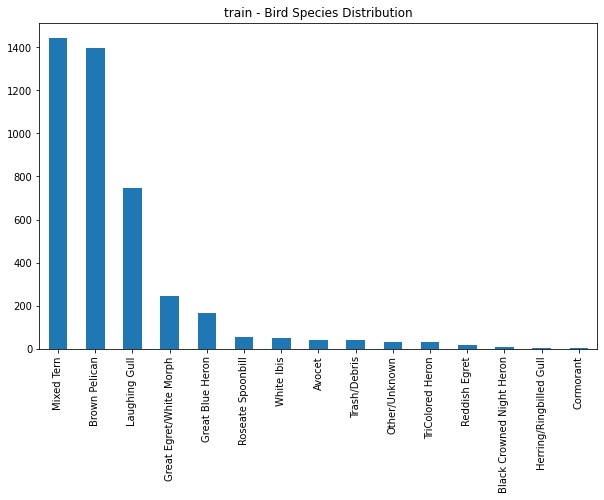

test data (first 5 rows):
   class_id               class_name    x    y  width  height
0         4  Great Egret/White Morph    0  129    121     119
1         4  Great Egret/White Morph   29  375    170     150
2         6        Roseate Spoonbill  445   49    150      96
3         1            Brown Pelican  419  160    221     191
4         1            Brown Pelican  199  307    268     165

 test data info:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 504 entries, 0 to 503
Data columns (total 6 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   class_id    504 non-null    int64 
 1   class_name  504 non-null    object
 2   x           504 non-null    int64 
 3   y           504 non-null    int64 
 4   width       504 non-null    int64 
 5   height      504 non-null    int64 
dtypes: int64(5), object(1)
memory usage: 23.8+ KB

 Bird Species Distribution
Brown Pelican                167
Mixed Tern                   158
Laughing Gull  

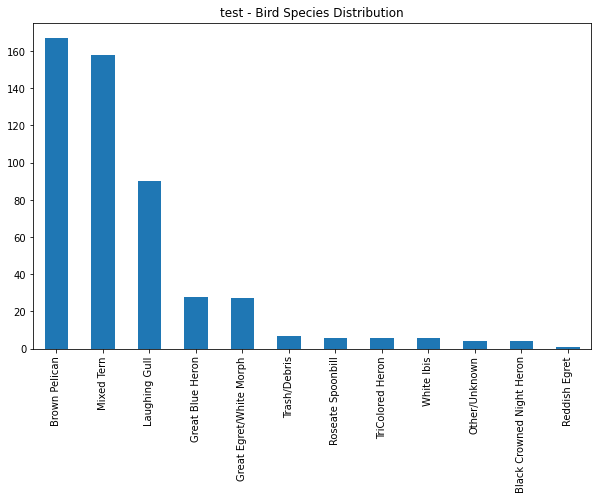

val data (first 5 rows):
   class_id     class_name    x    y  width  height
0         1  Brown Pelican  562   96     78     160
1         1  Brown Pelican  495  199     81     133
2         1  Brown Pelican  263  186    111     153
3         1  Brown Pelican  295  314    131     156
4         1  Brown Pelican  399  327     83     149

 val data info:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 540 entries, 0 to 539
Data columns (total 6 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   class_id    540 non-null    int64 
 1   class_name  540 non-null    object
 2   x           540 non-null    int64 
 3   y           540 non-null    int64 
 4   width       540 non-null    int64 
 5   height      540 non-null    int64 
dtypes: int64(5), object(1)
memory usage: 25.4+ KB

 Bird Species Distribution
Mixed Tern                   185
Brown Pelican                173
Laughing Gull                 88
Great Blue Heron              33
Great Egret

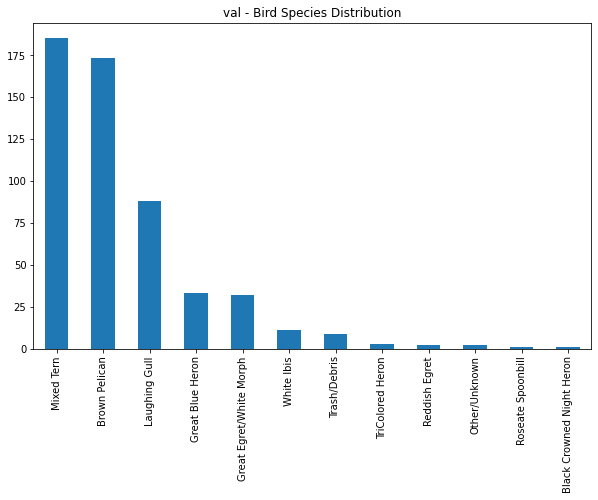

In [ ]:
import glob, os
import numpy as np 
import matplotlib.pyplot as plt
from skimage import io 
import pandas as pd

# data directory folders 
data_dir = 'data/'
dir_exceptions = ["Example"]
dirs = [d for d in os.listdir(data_dir) 
          if d not in dir_exceptions]

# Load CSV files 
target_data_dict = {}
for d in dirs: 
  target_data = []
  for f in glob.glob(os.path.join(data_dir,d,'*.csv')): 
    target_data.append(pd.read_csv(f, header=0, 
                              names = ["class_id", "class_name", "x", "y", "width", "height"]) )
  target_data = pd.concat(target_data, axis=0, ignore_index=True)

  # Visualize dataset 
  print(f'{d} data (first 5 rows):')
  print(target_data[:5]) 
  print(f'\n {d} data info:')
  target_data.info()
  print('\n Bird Species Distribution')
  print(target_data["class_name"].value_counts())
  print('\n')

  ax = target_data["class_name"].value_counts().plot.bar(x="Bird Species", y="Frequency",figsize=(10,6))  
  ax.set_title(f'{d} - Bird Species Distribution')
  plt.show()

  target_data_dict[d] = target_data 

In [ ]:
# TO DO: build detectron2 mapper to add data augmentations 

## Training

In [ ]:
from detectron2.engine.hooks import HookBase
import detectron2.utils.comm as comm
import torch
import time
from datetime import timedelta

class ValidationLossHook(HookBase): 
  """
  Code adapted from: https://gist.github.com/ortegatron/c0dad15e49c2b74de8bb09a5615d9f6b
  """
  def __init__(self, model, data_loader, eval_period=20):
    self._model = model
    self._period = eval_period
    self._data_loader = data_loader
  
  def _do_loss_eval(self): 
    losses = []
    for idx, inputs in enumerate(self._data_loader):            
      if torch.cuda.is_available():
        torch.cuda.synchronize()
      loss_batch = self._get_loss(inputs)
      losses.append(loss_batch)
    
    mean_loss = np.mean(losses)
    self.trainer.storage.put_scalar('validation_loss', mean_loss)
    comm.synchronize()

    return losses
          
  def _get_loss(self, data):
    # How loss is calculated on train_loop 
    metrics_dict = self._model(data)
    metrics_dict = {
        k: v.detach().cpu().item() if isinstance(v, torch.Tensor) else float(v)
        for k, v in metrics_dict.items()
    }
    total_losses_reduced = sum(loss for loss in metrics_dict.values())
    return total_losses_reduced
    
  def after_step(self):
    next_iter = self.trainer.iter + 1
    is_final = next_iter == self.trainer.max_iter
    if is_final or (self._period > 0 and next_iter % self._period == 0):
      self._do_loss_eval()

In [ ]:
# Build custom trainer with validation loss hook + evaluation  
from detectron2.data import DatasetMapper, build_detection_test_loader
from detectron2.engine import DefaultTrainer
from detectron2.evaluation import COCOEvaluator

class Trainer(DefaultTrainer): 
  @classmethod
  def build_evaluator(cls, cfg, dataset_name, output_folder=None):
    if output_folder is None:     
      return COCOEvaluator(dataset_name, output_dir=cfg.OUTPUT_DIR)
    else: 
      return COCOEvaluator(dataset_name, output_dir=output_folder)

  def build_hooks(self): 
    hooks = super().build_hooks()
    hooks.append(ValidationLossHook(
                              self.model,
                              build_detection_test_loader(
                                self.cfg,
                                self.cfg.DATASETS.TEST[0], # assume first testing dataset is validation dataset
                                DatasetMapper(self.cfg,True)
                                ), 
                              eval_period = 20,
                              )
    )
    return hooks 

### Bird only detector 

In [ ]:
from detectron2.structures import BoxMode
from detectron2.data import detection_utils as utils

def get_bird_dicts(data_dir,img_ext='.JPG',skip_empty_imgs=True): 
  """
  Format dataset to detectron2 standard format. 
  INPUTS: 
    data_dir -- directory containing dataset files 
    img_ext -- file extension for images in dataset
    skip_empty_imgs -- keep images with no birds 
  OUTPUTS: 
    dataset_dicts -- list of dictionaries in detectron2 standard format
  """ 
  
  dataset_dicts = []

  for idx,file_csv in enumerate(glob.glob(os.path.join(data_dir,'*.csv'))): 
    
    record = {}

    # image attributes 
    root, ext = os.path.splitext(file_csv)    
    file_img = root + img_ext
    height, width = cv2.imread(file_img).shape[:2]
    record["file_name"] = file_img
    record["image_id"] = idx
    record["height"] = height
    record["width"] = width
    
    # annotations 
    imgs_anns_df = pd.read_csv(file_csv, header=0, names = ["class_id", "class_name", "x", "y", "width", "height"])
    # skip empty images
    if skip_empty_imgs and imgs_anns_df.shape[0]==0: 
      continue
    # remove annotations for trash 
    imgs_anns_df = imgs_anns_df[imgs_anns_df["class_name"]!="Trash/Debris"]
    
    objs = []
    for idx, row in imgs_anns_df.iterrows():  
      obj = {
          "bbox": [row["x"], row["y"], row["width"], row["height"]],      
          "bbox_mode": BoxMode.XYWH_ABS,
          "category_id": 0,
      }
      objs.append(obj)

    record["annotations"] = objs
    dataset_dicts.append(record)

  return dataset_dicts


 train examples:


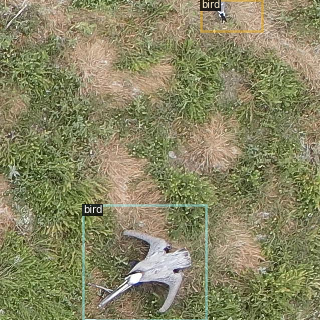

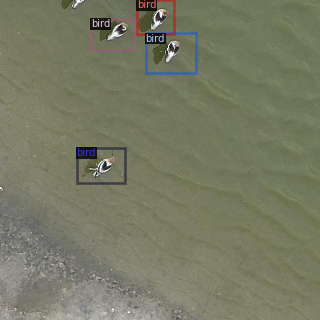

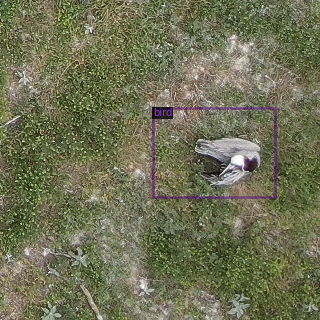


 test examples:


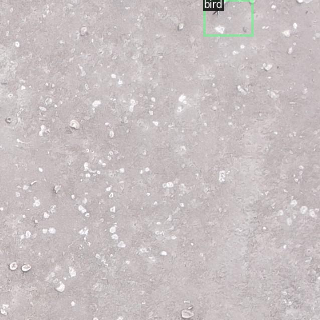

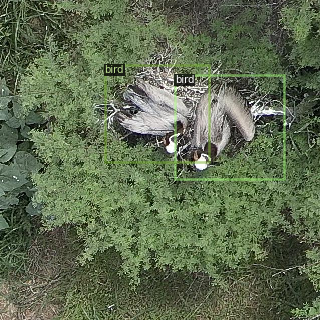

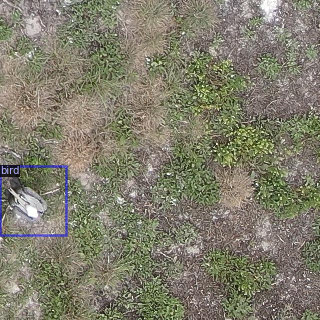


 val examples:


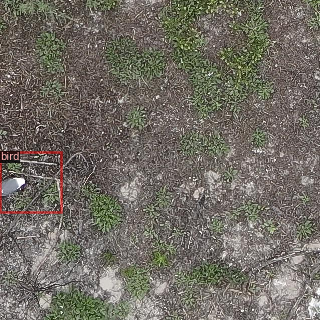

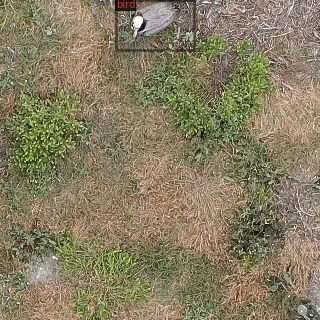

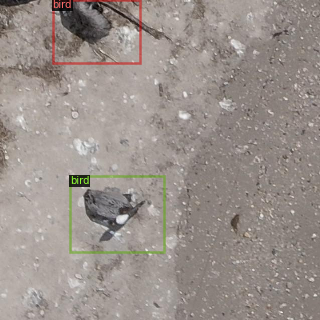

In [ ]:
data_dir = 'data/'
img_ext='.JPEG'
dir_exceptions = ["Annotations 20210912","UAV Image - XML - CSV - Ref"]


dirs = [d for d in os.listdir(data_dir) 
          if d not in dir_exceptions]
for d in dirs: 
  if f"birds_{d}" in DatasetCatalog.list():
      DatasetCatalog.remove(f"birds_{d}")
  if d=="train": 
    DatasetCatalog.register(f"birds_{d}", lambda d=d: get_bird_dicts(os.path.join(data_dir,d),img_ext,skip_empty_imgs=True))
  else: 
    DatasetCatalog.register(f"birds_{d}", lambda d=d: get_bird_dicts(os.path.join(data_dir,d),img_ext,skip_empty_imgs=False))
  if f"birds_{d}" in MetadataCatalog.list():
      MetadataCatalog.remove(f"birds_{d}")
  MetadataCatalog.get(f"birds_{d}").set(thing_classes=["bird"])

  dataset_dicts = get_bird_dicts(os.path.join(data_dir,d),img_ext)
  print(f"\n {d} examples:")
  for k in random.sample(dataset_dicts, 3):
      img = cv2.imread(k["file_name"])
      visualizer = Visualizer(img[:, :, ::-1], metadata=MetadataCatalog.get(f"birds_{d}"), scale=0.5)
      out = visualizer.draw_dataset_dict(k)
      cv2_imshow(out.get_image()[:, :, ::-1])

In [ ]:
from datetime import datetime
from distutils.dir_util import copy_tree

# Create detectron2 config and predictor 
cfg = get_cfg()
# add project-specific config (e.g., TensorMask) here if you're not running a model in detectron2's core library
model_name = "retinanet_R_50_FPN_1x"
cfg.merge_from_file(model_zoo.get_config_file(f"COCO-Detection/{model_name}.yaml"))
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5  # set threshold for this model
# Find a model from detectron2's model zoo. You can use the https://dl.fbaipublicfiles... url as well
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url(f"COCO-Detection/{model_name}.yaml")

cfg.DATASETS.TRAIN = ("birds_train",)
cfg.DATASETS.TEST = ("birds_val",) # "birds_test"
# cfg.TEST.EVAL_PERIOD = 20 # set to non-zero integer to get evaluation metric results 
cfg.DATALOADER.NUM_WORKERS = 4
cfg.SOLVER.IMS_PER_BATCH = 16
cfg.SOLVER.BASE_LR = 0.0001 # pick a good LR
cfg.SOLVER.MAX_ITER = 1000    
cfg.SOLVER.STEPS = []        # do not decay learning rate
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1  # only has one class (bird). (see https://detectron2.readthedocs.io/tutorials/datasets.html#update-the-config-for-new-datasets)
cfg.MODEL.RETINANET.NUM_CLASSES = 1
# NOTE: this config means the number of classes, but a few popular unofficial tutorials incorrect uses num_classes+1 here.
cfg.OUTPUT_DIR = f"./output/{model_name}_{datetime.now().strftime('%Y%m%d-%H%M%S')}"
os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)

trainer = Trainer(cfg) 
trainer.resume_or_load(resume=False)
trainer.train()

copy_tree(cfg.OUTPUT_DIR,f"../gdrive/MyDrive/Colab Notebooks/DSCI535-Audubon/output/{str(cfg.OUTPUT_DIR).replace('./output/','')}"

Loading config /usr/local/lib/python3.7/dist-packages/detectron2/model_zoo/configs/COCO-Detection/../Base-RetinaNet.yaml with yaml.unsafe_load. Your machine may be at risk if the file contains malicious content.


[10/20 17:16:11 d2.engine.defaults]: Model:
RetinaNet(
  (backbone): FPN(
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelP6P7(
      (p6): Conv2d(2048, 256, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
      (p7): Conv2d(256, 256, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    )
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res2)

/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


[10/20 17:16:29 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in training: [ResizeShortestEdge(short_edge_length=(640, 672, 704, 736, 768, 800), max_size=1333, sample_style='choice'), RandomFlip()]
[10/20 17:16:31 d2.data.build]: Distribution of instances among all 1 categories:
|  category  | #instances   |
|:----------:|:-------------|
|    bird    | 531          |
|            |              |
[10/20 17:16:31 d2.data.common]: Serializing 206 elements to byte tensors and concatenating them all ...
[10/20 17:16:31 d2.data.common]: Serialized dataset takes 0.05 MiB


/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))
model_final_bfca0b.pkl: 152MB [00:26, 5.69MB/s]                           
Skip loading parameter 'head.cls_score.weight' to the model due to incompatible shapes: (720, 256, 3, 3) in the checkpoint but (9, 256, 3, 3) in the model! You might want to double check if this is expected.
Skip loading parameter 'head.cls_score.bias' to the model due to incompatible shapes: (720,) in the checkpoint but (9,) in the model! You might want to double check if this is expected.
Some model parameters or buffers are not found in the checkpoint:
head.cls_

[10/20 17:16:58 d2.engine.train_loop]: Starting training from iteration 0


/usr/local/lib/python3.7/dist-packages/torch/_tensor.py:575: UserWarning: floor_divide is deprecated, and will be removed in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values.
To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor'). (Triggered internally at  /pytorch/aten/src/ATen/native/BinaryOps.cpp:467.)
  return torch.floor_divide(self, other)
/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:718: UserWarning: Named tensors and all their associated APIs are an experimental feature and subject to change. Please do not use them for anything important until they are released as stable. (Triggered internally at  /pytorch/c10/core/TensorImpl.h:1156.)
  return torch.max_pool2d(input, kernel_size, stride, padding, dilation, ceil_mode)


[10/20 17:18:05 d2.utils.events]:  eta: 0:57:06  iter: 19  total_loss: 2.121  loss_cls: 1.381  loss_box_reg: 0.7174  time: 3.4081  data_time: 0.0983  lr: 1.9981e-06  max_mem: 4747M
[10/20 17:19:44 d2.utils.events]:  eta: 0:49:23  iter: 39  total_loss: 2.22  loss_cls: 1.414  loss_box_reg: 0.8058  validation_loss: 1.521  time: 3.1434  data_time: 0.0720  lr: 3.9961e-06  max_mem: 4747M
[10/20 17:21:24 d2.utils.events]:  eta: 0:46:19  iter: 59  total_loss: 2.361  loss_cls: 1.487  loss_box_reg: 0.8136  validation_loss: 1.514  time: 3.0698  data_time: 0.0798  lr: 5.9941e-06  max_mem: 4747M
[10/20 17:23:01 d2.utils.events]:  eta: 0:45:17  iter: 79  total_loss: 2.46  loss_cls: 1.594  loss_box_reg: 0.8659  validation_loss: 1.508  time: 3.0155  data_time: 0.0889  lr: 7.9921e-06  max_mem: 4747M
[10/20 17:24:39 d2.utils.events]:  eta: 0:44:16  iter: 99  total_loss: 2.199  loss_cls: 1.446  loss_box_reg: 0.7533  validation_loss: 1.488  time: 2.9813  data_time: 0.0724  lr: 9.9901e-06  max_mem: 4747M
[

In [ ]:
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir output

<IPython.core.display.Javascript object>

In [ ]:
from distutils.dir_util import copy_tree
copy_tree(cfg.OUTPUT_DIR,f"../gdrive/MyDrive/Colab Notebooks/DSCI535-Audubon/output/{str(cfg.OUTPUT_DIR).replace('./output/','')}")

['../gdrive/MyDrive/Colab Notebooks/DSCI535-Audubon/output/retinanet_R_50_FPN_1x_20211020-171608/birds_val_coco_format.json.lock',
 '../gdrive/MyDrive/Colab Notebooks/DSCI535-Audubon/output/retinanet_R_50_FPN_1x_20211020-171608/model_final.pth',
 '../gdrive/MyDrive/Colab Notebooks/DSCI535-Audubon/output/retinanet_R_50_FPN_1x_20211020-171608/last_checkpoint',
 '../gdrive/MyDrive/Colab Notebooks/DSCI535-Audubon/output/retinanet_R_50_FPN_1x_20211020-171608/events.out.tfevents.1634750189.aae7fbaa9bdd.434.0',
 '../gdrive/MyDrive/Colab Notebooks/DSCI535-Audubon/output/retinanet_R_50_FPN_1x_20211020-171608/instances_predictions.pth',
 '../gdrive/MyDrive/Colab Notebooks/DSCI535-Audubon/output/retinanet_R_50_FPN_1x_20211020-171608/coco_instances_results.json',
 '../gdrive/MyDrive/Colab Notebooks/DSCI535-Audubon/output/retinanet_R_50_FPN_1x_20211020-171608/metrics.json',
 '../gdrive/MyDrive/Colab Notebooks/DSCI535-Audubon/output/retinanet_R_50_FPN_1x_20211020-171608/birds_val_coco_format.json']

### Bird species detector 

In [ ]:
from detectron2.structures import BoxMode
from detectron2.data import detection_utils as utils

def get_bird_species_dicts(data_dir,class_names,img_ext='.JPG',skip_empty_imgs=True): 
  """
  Format dataset to detectron2 standard format. 
  INPUTS: 
    data_dir -- directory containing dataset files 
    img_ext -- file extension for images in dataset
    class_names -- 
    skip_empty_imgs -- keep images with no birds 
  OUTPUTS: 
    dataset_dicts -- list of dictionaries in detectron2 standard format
  """ 
  
  dataset_dicts = []

  for idx,file_csv in enumerate(glob.glob(os.path.join(data_dir,'*.csv'))): 
    
    record = {}

    # image attributes 
    root, ext = os.path.splitext(file_csv)    
    file_img = root + img_ext
    height, width = cv2.imread(file_img).shape[:2]
    record["file_name"] = file_img
    record["image_id"] = idx
    record["height"] = height
    record["width"] = width
    
    # annotations 
    imgs_anns_df = pd.read_csv(file_csv, header=0, names = ["class_id", "class_name", "x", "y", "width", "height"])
    # skip empty images
    if skip_empty_imgs and imgs_anns_df.shape[0]==0: 
      continue
    # remove annotations for trash 
    imgs_anns_df = imgs_anns_df[imgs_anns_df["class_name"]!="Trash/Debris"]
    
    objs = []
    for idx, row in imgs_anns_df.iterrows():  
      try: 
        id = class_names.index(row["class_name"])
        obj = {
            "bbox": [row["x"], row["y"], row["width"], row["height"]],      
            "bbox_mode": BoxMode.XYWH_ABS,
            "category_id": id, 
            }
        objs.append(obj)
      except ValueError: 
        obj = {"bbox": [row["x"], row["y"], row["width"], row["height"]],      
              "bbox_mode": BoxMode.XYWH_ABS,
              "category_id": len(class_names)}
        objs.append(obj)

    record["annotations"] = objs
    dataset_dicts.append(record)

  return dataset_dicts


 train examples:


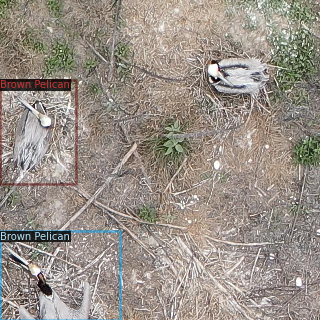

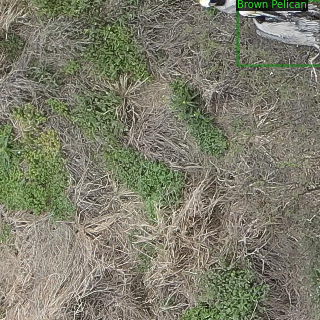

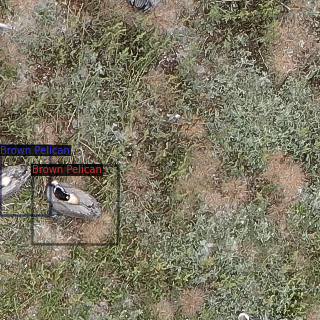


 test examples:


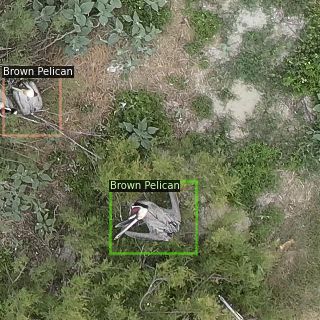

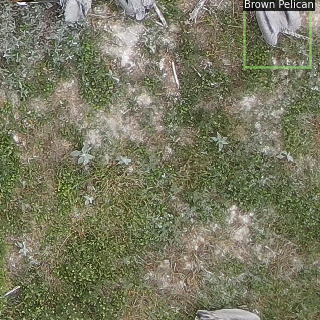

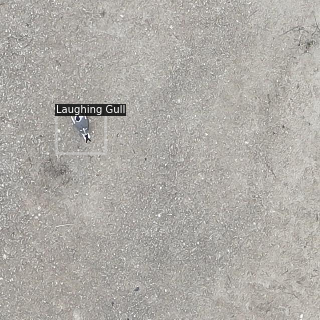


 val examples:


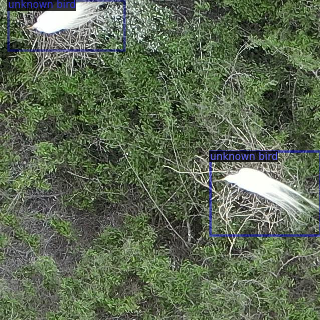

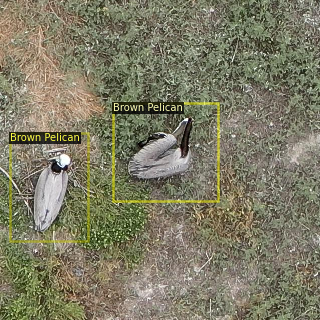

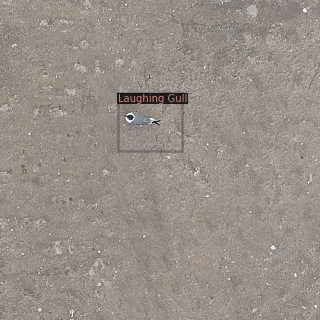

In [ ]:
data_dir = 'data/'
img_ext='.JPEG'
dir_exceptions = ["Annotations 20210912","UAV Image - XML - CSV - Ref"]

class_names = ["Brown Pelican","Mixed Tern","Laughing Gull"]
num_classes = len(class_names) + 1

dirs = [d for d in os.listdir(data_dir) 
          if d not in dir_exceptions]
for d in dirs: 
  if f"birds_{d}" in DatasetCatalog.list():
      DatasetCatalog.remove(f"birds_{d}")
  if d=="train": 
    DatasetCatalog.register(f"birds_{d}", lambda d=d: get_bird_species_dicts(os.path.join(data_dir,d),class_names,img_ext,skip_empty_imgs=True))
  else: 
    DatasetCatalog.register(f"birds_{d}", lambda d=d: get_bird_species_dicts(os.path.join(data_dir,d),class_names,img_ext,skip_empty_imgs=False))
  if f"birds_{d}" in MetadataCatalog.list():
      MetadataCatalog.remove(f"birds_{d}")
  MetadataCatalog.get(f"birds_{d}").set(thing_classes=class_names+["unknown bird"])

  dataset_dicts = get_bird_species_dicts(os.path.join(data_dir,d),class_names,img_ext)
  print(f"\n {d} examples:")
  for k in random.sample(dataset_dicts, 3):
      img = cv2.imread(k["file_name"])
      visualizer = Visualizer(img[:, :, ::-1], metadata=MetadataCatalog.get(f"birds_{d}"), scale=0.5)
      out = visualizer.draw_dataset_dict(k)
      cv2_imshow(out.get_image()[:, :, ::-1])

In [ ]:
from datetime import datetime
from distutils.dir_util import copy_tree

model_dir = "/gdrive/MyDrive/Colab Notebooks/DSCI535-Audubon/output/"
model_name = "retinanet_R_50_FPN_1x"
model_id = "20211020-195059"

# Create detectron2 config and predictor 
cfg = get_cfg()
# add project-specific config (e.g., TensorMask) here if you're not running a model in detectron2's core library
cfg.merge_from_file(model_zoo.get_config_file(f"COCO-Detection/{model_name}.yaml"))
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5  # set threshold for this model
# Get pretrained model from bird only detector
cfg.MODEL.WEIGHTS = os.path.join(model_dir, f"multibirds_{model_name}_{model_id}/model_final.pth") # path to the model we just trained

cfg.DATASETS.TRAIN = ("birds_train",)
cfg.DATASETS.TEST = ("birds_val",) # "birds_test"
# cfg.TEST.EVAL_PERIOD = 20 # set to non-zero integer to get evaluation metric results 
cfg.DATALOADER.NUM_WORKERS = 4
cfg.SOLVER.IMS_PER_BATCH = 16
cfg.SOLVER.BASE_LR = 0.0001 # pick a good LR
cfg.SOLVER.MAX_ITER = 500    # 300 iterations seems good enough for this toy dataset; you will need to train longer for a practical dataset
cfg.SOLVER.STEPS = []        # do not decay learning rate
cfg.SOLVER.WARMUP_ITERS = 1
cfg.MODEL.ROI_HEADS.NUM_CLASSES = num_classes  # only has one class (bird). (see https://detectron2.readthedocs.io/tutorials/datasets.html#update-the-config-for-new-datasets)
cfg.MODEL.RETINANET.NUM_CLASSES = num_classes
# NOTE: this config means the number of classes, but a few popular unofficial tutorials incorrect uses num_classes+1 here.
cfg.OUTPUT_DIR = f"./output/multibirds_{model_name}_{datetime.now().strftime('%Y%m%d-%H%M%S')}"
os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)

trainer = Trainer(cfg) 
trainer.resume_or_load(resume=False)
trainer.train()

copy_tree(cfg.OUTPUT_DIR,f"../gdrive/MyDrive/Colab Notebooks/DSCI535-Audubon/output/{str(cfg.OUTPUT_DIR).replace('./output/','')}")

Loading config /usr/local/lib/python3.7/dist-packages/detectron2/model_zoo/configs/COCO-Detection/../Base-RetinaNet.yaml with yaml.unsafe_load. Your machine may be at risk if the file contains malicious content.


[10/22 17:35:18 d2.engine.defaults]: Model:
RetinaNet(
  (backbone): FPN(
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelP6P7(
      (p6): Conv2d(2048, 256, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
      (p7): Conv2d(256, 256, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    )
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res2)

/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


[10/22 17:35:36 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in training: [ResizeShortestEdge(short_edge_length=(640, 672, 704, 736, 768, 800), max_size=1333, sample_style='choice'), RandomFlip()]
[10/22 17:35:38 d2.data.build]: Distribution of instances among all 4 categories:
|   category    | #instances   |  category  | #instances   |   category    | #instances   |
|:-------------:|:-------------|:----------:|:-------------|:-------------:|:-------------|
| Brown Pelican | 173          | Mixed Tern | 185          | Laughing Gull | 88           |
| unknown bird  | 85           |            |              |               |              |
|     total     | 531          |            |              |               |              |
[10/22 17:35:38 d2.data.common]: Serializing 206 elements to byte tensors and concatenating them all ...
[10/22 17:35:38 d2.data.common]: Serialized dataset takes 0.05 MiB


/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


[10/22 17:35:43 d2.engine.train_loop]: Starting training from iteration 0


/usr/local/lib/python3.7/dist-packages/torch/_tensor.py:575: UserWarning: floor_divide is deprecated, and will be removed in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values.
To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor'). (Triggered internally at  /pytorch/aten/src/ATen/native/BinaryOps.cpp:467.)
  return torch.floor_divide(self, other)
/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:718: UserWarning: Named tensors and all their associated APIs are an experimental feature and subject to change. Please do not use them for anything important until they are released as stable. (Triggered internally at  /pytorch/c10/core/TensorImpl.h:1156.)
  return torch.max_pool2d(input, kernel_size, stride, padding, dilation, ceil_mode)


[10/22 17:37:27 d2.utils.events]:  eta: 0:42:08  iter: 19  total_loss: 0.9521  loss_cls: 0.4621  loss_box_reg: 0.4269  time: 5.2766  data_time: 0.2837  lr: 0.0001  max_mem: 9106M
[10/22 17:39:43 d2.utils.events]:  eta: 0:38:43  iter: 39  total_loss: 0.8688  loss_cls: 0.4101  loss_box_reg: 0.4304  validation_loss: 0.4659  time: 4.9800  data_time: 0.2660  lr: 0.0001  max_mem: 9106M
[10/22 17:41:57 d2.utils.events]:  eta: 0:34:36  iter: 59  total_loss: 1.056  loss_cls: 0.4517  loss_box_reg: 0.5555  validation_loss: 0.4544  time: 4.8824  data_time: 0.2628  lr: 0.0001  max_mem: 9106M
[10/22 17:43:01 d2.engine.hooks]: Overall training speed: 62 iterations in 0:05:06 (4.9469 s / it)
[10/22 17:43:01 d2.engine.hooks]: Total training time: 0:07:09 (0:02:02 on hooks)
[10/22 17:43:01 d2.utils.events]:  eta: 0:34:13  iter: 64  total_loss: 1.038  loss_cls: 0.4517  loss_box_reg: 0.5205  validation_loss: 0.4462  time: 4.8709  data_time: 0.2630  lr: 0.0001  max_mem: 9106M


ERROR:root:Internal Python error in the inspect module.
Below is the traceback from this internal error.



Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py", line 2882, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-8-a68e03b514d3>", line 33, in <module>
    trainer.train()
  File "/usr/local/lib/python3.7/dist-packages/detectron2/engine/defaults.py", line 487, in train
    super().train(self.start_iter, self.max_iter)
  File "/usr/local/lib/python3.7/dist-packages/detectron2/engine/train_loop.py", line 149, in train
    self.run_step()
  File "/usr/local/lib/python3.7/dist-packages/detectron2/engine/defaults.py", line 497, in run_step
    self._trainer.run_step()
  File "/usr/local/lib/python3.7/dist-packages/detectron2/engine/train_loop.py", line 287, in run_step
    self._write_metrics(loss_dict, data_time)
  File "/usr/local/lib/python3.7/dist-packages/detectron2/engine/train_loop.py", line 302, in _write_metrics
    SimpleTrainer.write_metrics(loss_dict, data_time, prefix)
  File

KeyboardInterrupt: ignored

In [ ]:
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir output

<IPython.core.display.Javascript object>

## Evaluation 

In [ ]:
import numpy as np
import itertools
import detectron2.utils.comm as comm
from pycocotools.cocoeval import COCOeval
from detectron2.evaluation.fast_eval_api import COCOeval_opt
from detectron2.evaluation.coco_evaluation import COCOEvaluator

class PrecisionRecallEvaluator(COCOEvaluator):
    """
    Evaluate all Precision-Recall metrics for instance detection obtained from detectron2 COCOEvalulator
    """
    def __init__(self,dataset_name,output_dir=None):
        super().__init__(dataset_name, output_dir=output_dir)

    def evaluate(self, img_ids=None):
        """
        Args:
            img_ids: a list of image IDs to evaluate on. Default to None for the whole dataset
        Outputs: (see COCOEval API for details)
            precisions  - [TxRxKxAxM] precision for every evaluation setting
            recalls    - [TxKxAxM] max recall for every evaluation setting

        """
        if self._distributed:
            comm.synchronize()
            predictions = comm.gather(self._predictions, dst=0)
            predictions = list(itertools.chain(*predictions))

            if not comm.is_main_process():
                return {}
        else:
            predictions = self._predictions

        if len(predictions) == 0:
            self._logger.warning("[COCOEvaluator] Did not receive valid predictions.")
            return {}

        coco_eval = self._coco_eval_predictions(predictions, img_ids=img_ids)

        if coco_eval is None:
            self._logger.warn("No predictions from the model!")
            return ([],[])

        # Compute per-category AP
        # from https://github.com/facebookresearch/Detectron/blob/a6a835f5b8208c45d0dce217ce9bbda915f44df7/detectron/datasets/json_dataset_evaluator.py#L222-L252 # noqa
        precisions = coco_eval.eval["precision"]  # precision has dims (iou, recall, cls, area range, max dets)
        assert len(self._metadata.get("thing_classes")) == precisions.shape[2]
        recalls = coco_eval.eval["recall"]
        assert len(self._metadata.get("thing_classes")) == recalls.shape[1]

        return (precisions, recalls)

    def _coco_eval_predictions(self, predictions, img_ids=None):
        """
        Evaluate predictions.
        """
        coco_results = list(itertools.chain(*[x["instances"] for x in predictions]))

        # unmap the category ids for COCO
        if hasattr(self._metadata, "thing_dataset_id_to_contiguous_id"):
            dataset_id_to_contiguous_id = self._metadata.thing_dataset_id_to_contiguous_id
            all_contiguous_ids = list(dataset_id_to_contiguous_id.values())
            num_classes = len(all_contiguous_ids)
            assert min(all_contiguous_ids) == 0 and max(all_contiguous_ids) == num_classes - 1

            reverse_id_mapping = {v: k for k, v in dataset_id_to_contiguous_id.items()}
            for result in coco_results:
                category_id = result["category_id"]
                assert category_id < num_classes, (
                    f"A prediction has class={category_id}, "
                    f"but the dataset only has {num_classes} classes and "
                    f"predicted class id should be in [0, {num_classes - 1}]."
                )
                result["category_id"] = reverse_id_mapping[category_id]

        if not self._do_evaluation:
            self._logger.info("Annotations are not available for evaluation.")
            return

        self._logger.info(
            "Evaluating predictions with {} COCO API...".format(
                "unofficial" if self._use_fast_impl else "official"
            )
        )

        coco_dt = self._coco_api.loadRes(coco_results)
        coco_eval = (COCOeval_opt if self._use_fast_impl else COCOeval)(self._coco_api, coco_dt, "bbox")
        if img_ids is not None:
            coco_eval.params.imgIds = img_ids

        coco_eval.evaluate()
        coco_eval.accumulate()

        return coco_eval

### evaluate directly after training

In [ ]:
# Inference should use the config with parameters that are used in training
# cfg now already contains everything we've set previously. We changed it a little bit for inference:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")  # path to the model we just trained
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7   # set a custom testing threshold
predictor = DefaultPredictor(cfg)

AssertionError: ignored

In [ ]:
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader

val_evaluator = COCOEvaluator("birds_val", output_dir=cfg.OUTPUT_DIR)
val_loader = build_detection_test_loader(cfg, "birds_val")
print('validation inference:',inference_on_dataset(predictor.model, val_loader, val_evaluator))
test_evaluator = COCOEvaluator("birds_test", output_dir=cfg.OUTPUT_DIR)
test_loader = build_detection_test_loader(cfg, "birds_test")
print('test inference:',inference_on_dataset(predictor.model, test_loader, test_evaluator))
# another equivalent way to evaluate the model is to use `trainer.test`

In [ ]:
from detectron2.utils.visualizer import ColorMode

for d in ["val", "test"]: 
  dataset_dicts = get_bird_dicts(os.path.join(data_dir,d),img_ext)
  print(f'\n {d} examples:')
  for k in random.sample(dataset_dicts, 3):    
      im = cv2.imread(k["file_name"])
      outputs = predictor(im)  # format is documented at https://detectron2.readthedocs.io/tutorials/models.html#model-output-format
      outputs = outputs["instances"].to("cpu")
      outputs = outputs[outputs.scores > 0.8]
      v = Visualizer(im[:, :, ::-1],
                    metadata=MetadataCatalog.get(f"birds_{d}"), 
                    scale=0.5, 
                    instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels. This option is only available for segmentation models
      )
      out = v.draw_instance_predictions(outputs)
      cv2_imshow(out.get_image()[:, :, ::-1])

### load evaluation model


#### bird only detector

In [ ]:
model_dir = "/gdrive/MyDrive/Colab Notebooks/DSCI535-Audubon/output/"
model_name = "retinanet_R_50_FPN_1x"
model_id = "bird_only"

# Create detectron2 config and predictor 
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file(f"COCO-Detection/{model_name}.yaml"))
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5  # set threshold for this model
cfg.MODEL.WEIGHTS = os.path.join(model_dir, f"{model_name}_{model_id}/model_final.pth") # path to the model we just trained

cfg.DATASETS.TRAIN = ("birds_train",)
cfg.DATASETS.TEST = ("birds_val","birds_test") 
# cfg.TEST.EVAL_PERIOD = 20 # set to non-zero integer to get evaluation metric results 
cfg.DATALOADER.NUM_WORKERS = 4
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 64   # faster, and good enough for this toy dataset (default: 512)
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1  # only has one class (bird). (see https://detectron2.readthedocs.io/tutorials/datasets.html#update-the-config-for-new-datasets)
cfg.MODEL.RETINANET.NUM_CLASSES = 1


# cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7   # set a custom testing threshold
predictor = DefaultPredictor(cfg)

Loading config /usr/local/lib/python3.7/dist-packages/detectron2/model_zoo/configs/COCO-Detection/../Base-RetinaNet.yaml with yaml.unsafe_load. Your machine may be at risk if the file contains malicious content.


In [ ]:
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader

val_evaluator = COCOEvaluator("birds_val", output_dir=cfg.OUTPUT_DIR)
val_loader = build_detection_test_loader(cfg, "birds_val")
print('validation inference:',inference_on_dataset(predictor.model, val_loader, val_evaluator))

test_evaluator = COCOEvaluator("birds_test", output_dir=cfg.OUTPUT_DIR)
test_loader = build_detection_test_loader(cfg, "birds_test")
print('test inference:',inference_on_dataset(predictor.model, test_loader, test_evaluator))

# another equivalent way to evaluate the model is to use `trainer.test`

[10/25 16:31:15 d2.evaluation.coco_evaluation]: 'birds_val' is not registered by `register_coco_instances`. Therefore trying to convert it to COCO format ...
[10/25 16:31:15 d2.data.datasets.coco]: Converting annotations of dataset 'birds_val' to COCO format ...)
[10/25 16:31:17 d2.data.datasets.coco]: Converting dataset dicts into COCO format
[10/25 16:31:17 d2.data.datasets.coco]: Conversion finished, #images: 206, #annotations: 531
[10/25 16:31:17 d2.data.datasets.coco]: Caching COCO format annotations at './output/birds_val_coco_format.json' ...
[10/25 16:31:19 d2.data.build]: Distribution of instances among all 1 categories:
|  category  | #instances   |
|:----------:|:-------------|
|    bird    | 531          |
|            |              |
[10/25 16:31:19 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[10/25 16:31:19 d2.data.common]: Serializing 206 elements to by

/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))
/usr/local/lib/python3.7/dist-packages/torch/_tensor.py:575: UserWarning: floor_divide is deprecated, and will be removed in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values.
To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor'). (Triggered internally at  /pytorch/aten/src/ATen/native/BinaryOps.cpp:467.)
  return torch.floor_divide(self, other)

[10/25 16:31:22 d2.evaluation.evaluator]: Inference done 11/206. Dataloading: 0.0017 s/iter. Inference: 0.2316 s/iter. Eval: 0.0003 s/iter. Total: 0.2335 s/iter. ETA=0:00:45
[10/25 16:31:27 d2.evaluation.evaluator]: Inference done 33/206. Dataloading: 0.0019 s/iter. Inference: 0.2268 s/iter. Eval: 0.0003 s/iter. Total: 0.2292 s/iter. ETA=0:00:39
[10/25 16:31:32 d2.evaluation.evaluator]: Inference done 55/206. Dataloading: 0.0019 s/iter. Inference: 0.2260 s/iter. Eval: 0.0003 s/iter. Total: 0.2284 s/iter. ETA=0:00:34
[10/25 16:31:37 d2.evaluation.evaluator]: Inference done 77/206. Dataloading: 0.0021 s/iter. Inference: 0.2259 s/iter. Eval: 0.0003 s/iter. Total: 0.2285 s/iter. ETA=0:00:29
[10/25 16:31:42 d2.evaluation.evaluator]: Inference done 99/206. Dataloading: 0.0021 s/iter. Inference: 0.2259 s/iter. Eval: 0.0003 s/iter. Total: 0.2284 s/iter. ETA=0:00:24
[10/25 16:31:47 d2.evaluation.evaluator]: Inference done 121/206. Dataloading: 0.0022 s/iter. Inference: 0.2260 s/iter. Eval: 0.00

[10/25 16:33:21 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[10/25 16:33:21 d2.data.common]: Serializing 208 elements to byte tensors and concatenating them all ...
[10/25 16:33:21 d2.data.common]: Serialized dataset takes 0.05 MiB
[10/25 16:33:21 d2.evaluation.evaluator]: Start inference on 208 batches


/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


[10/25 16:33:24 d2.evaluation.evaluator]: Inference done 11/208. Dataloading: 0.0011 s/iter. Inference: 0.2322 s/iter. Eval: 0.0003 s/iter. Total: 0.2336 s/iter. ETA=0:00:46
[10/25 16:33:29 d2.evaluation.evaluator]: Inference done 33/208. Dataloading: 0.0021 s/iter. Inference: 0.2277 s/iter. Eval: 0.0003 s/iter. Total: 0.2304 s/iter. ETA=0:00:40
[10/25 16:33:34 d2.evaluation.evaluator]: Inference done 55/208. Dataloading: 0.0022 s/iter. Inference: 0.2275 s/iter. Eval: 0.0003 s/iter. Total: 0.2301 s/iter. ETA=0:00:35
[10/25 16:33:39 d2.evaluation.evaluator]: Inference done 77/208. Dataloading: 0.0021 s/iter. Inference: 0.2272 s/iter. Eval: 0.0003 s/iter. Total: 0.2298 s/iter. ETA=0:00:30
[10/25 16:33:44 d2.evaluation.evaluator]: Inference done 99/208. Dataloading: 0.0021 s/iter. Inference: 0.2272 s/iter. Eval: 0.0003 s/iter. Total: 0.2298 s/iter. ETA=0:00:25
[10/25 16:33:49 d2.evaluation.evaluator]: Inference done 121/208. Dataloading: 0.0021 s/iter. Inference: 0.2274 s/iter. Eval: 0.00

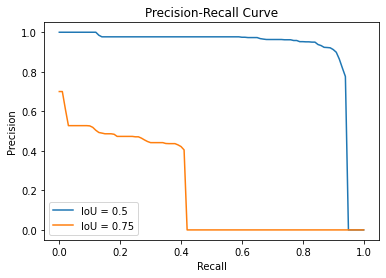

[0.94567404 0.89738431 0.83299799 0.75251509 0.60764588 0.41851107
 0.24547284 0.11066398 0.03219316 0.00402414]


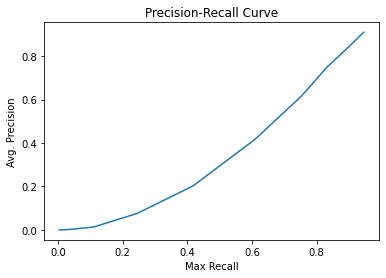

In [ ]:
recall = np.linspace(0,1,101)
# (val_precisions, val_recalls) = inference_on_dataset(predictor.model, 
#                                                        build_detection_test_loader(cfg, "birds_val"), 
#                                                        PrecisionRecallEvaluator("birds_val", output_dir=cfg.OUTPUT_DIR)
# )



# val_precisions_iou50 = np.squeeze(val_precisions[0,:,0,0,-1]) 

# plt.plot(recall,val_precisions_iou50)
# plt.show()

(test_precisions, test_recalls) = inference_on_dataset(predictor.model, 
                                                       build_detection_test_loader(cfg, "birds_test"), 
                                                       PrecisionRecallEvaluator("birds_test", output_dir=cfg.OUTPUT_DIR)
)

test_precisions_iou50 = np.squeeze(test_precisions[0,:,0,0,-1]) 
test_precisions_iou75 = np.squeeze(test_precisions[5,:,0,0,-1]) 

fig, ax = plt.subplots()
ax.plot(recall,test_precisions_iou50)
ax.plot(recall,test_precisions_iou75)
ax.set(title="Precision-Recall Curve",
       ylabel="Precision",
       xlabel="Recall")
ax.legend(["IoU = 0.5","IoU = 0.75"],loc='lower left')
plt.show()

test_avg_precision = np.mean(np.squeeze(test_precisions[:,:,0,0,-1]),axis=1) 
test_max_recall = np.squeeze(test_recalls[:,0,0,-1])

print(test_max_recall)

fig, ax = plt.subplots()
ax.plot(test_max_recall,test_avg_precision)
ax.set(title="Precision-Recall Curve",
       ylabel="Avg. Precision",
       xlabel="Max Recall")
plt.show()



 val examples:


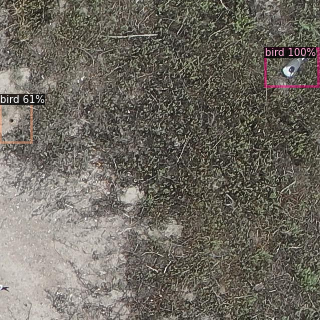

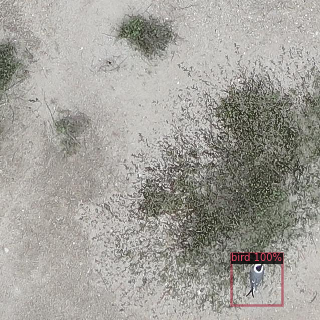

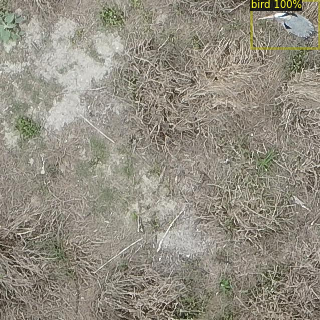

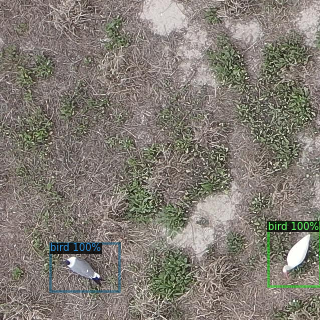

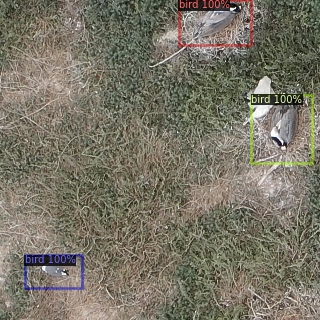


 test examples:


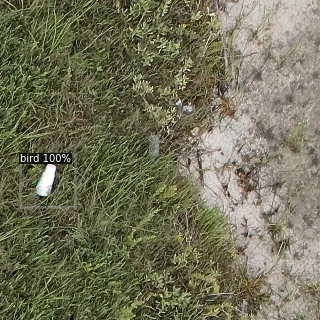

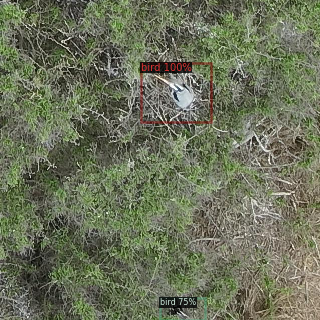

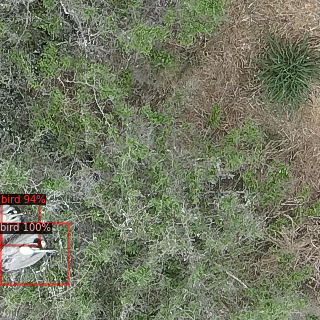

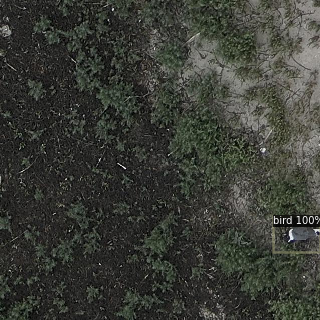

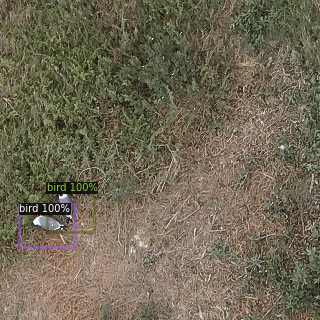

In [ ]:
from detectron2.utils.visualizer import ColorMode

for d in ["val", "test"]: 
  dataset_dicts = get_bird_dicts(os.path.join(data_dir,d),img_ext)
  print(f'\n {d} examples:')
  for k in random.sample(dataset_dicts, 5):    
      im = cv2.imread(k["file_name"])
      outputs = predictor(im)  # format is documented at https://detectron2.readthedocs.io/tutorials/models.html#model-output-format
      outputs = outputs["instances"].to("cpu")
      outputs = outputs[outputs.scores > 0.5]
      v = Visualizer(im[:, :, ::-1],
                    metadata=MetadataCatalog.get(f"birds_{d}"), 
                    scale=0.5, 
                    instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels. This option is only available for segmentation models
      )
      out = v.draw_instance_predictions(outputs)
      cv2_imshow(out.get_image()[:, :, ::-1])

In [ ]:
%load_ext tensorboard
%tensorboard --logdir "../gdrive/MyDrive/Colab Notebooks/DSCI535-Audubon/output/"

#### bird species detector

In [ ]:
model_dir = "/gdrive/MyDrive/Colab Notebooks/DSCI535-Audubon/output/"
model_name = "retinanet_R_50_FPN_1x"
model_id = "20211020-234548"

# Create detectron2 config and predictor 
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file(f"COCO-Detection/{model_name}.yaml"))
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5  # set threshold for this model
cfg.MODEL.WEIGHTS = os.path.join(model_dir, f"multibirds_{model_name}_{model_id}/model_final.pth") # path to the model we just trained

cfg.DATASETS.TRAIN = ("birds_train",)
cfg.DATASETS.TEST = ("birds_val","birds_test") 
cfg.DATALOADER.NUM_WORKERS = 4
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 4  # only has one class (bird). (see https://detectron2.readthedocs.io/tutorials/datasets.html#update-the-config-for-new-datasets)
cfg.MODEL.RETINANET.NUM_CLASSES = 4

cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5   # set a custom testing threshold
predictor = DefaultPredictor(cfg)

Loading config /usr/local/lib/python3.7/dist-packages/detectron2/model_zoo/configs/COCO-Detection/../Base-RetinaNet.yaml with yaml.unsafe_load. Your machine may be at risk if the file contains malicious content.


In [ ]:
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader

val_evaluator = COCOEvaluator("birds_val", output_dir=cfg.OUTPUT_DIR)
val_loader = build_detection_test_loader(cfg, "birds_val")
print('validation inference:',inference_on_dataset(predictor.model, val_loader, val_evaluator))

test_evaluator = COCOEvaluator("birds_test", output_dir=cfg.OUTPUT_DIR)
test_loader = build_detection_test_loader(cfg, "birds_test")
print('test inference:',inference_on_dataset(predictor.model, test_loader, test_evaluator))

(test_precisions, test_recalls) = inference_on_dataset(predictor.model, 
                                                       build_detection_test_loader(cfg, "birds_test"), 
                                                       PrecisionRecallEvaluator("birds_test", output_dir=cfg.OUTPUT_DIR)) 

[10/26 18:27:53 d2.evaluation.coco_evaluation]: Trying to convert 'birds_val' to COCO format ...
[10/26 18:27:53 d2.data.datasets.coco]: Converting annotations of dataset 'birds_val' to COCO format ...)
[10/26 18:27:55 d2.data.datasets.coco]: Converting dataset dicts into COCO format
[10/26 18:27:55 d2.data.datasets.coco]: Conversion finished, #images: 206, #annotations: 531
[10/26 18:27:55 d2.data.datasets.coco]: Caching COCO format annotations at './output/birds_val_coco_format.json' ...
[10/26 18:27:57 d2.data.build]: Distribution of instances among all 4 categories:
|   category    | #instances   |  category  | #instances   |   category    | #instances   |
|:-------------:|:-------------|:----------:|:-------------|:-------------:|:-------------|
| Brown Pelican | 173          | Mixed Tern | 185          | Laughing Gull | 88           |
| unknown bird  | 85           |            |              |               |              |
|     total     | 531          |            |          

/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))
/usr/local/lib/python3.7/dist-packages/torch/_tensor.py:575: UserWarning: floor_divide is deprecated, and will be removed in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values.
To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor'). (Triggered internally at  /pytorch/aten/src/ATen/native/BinaryOps.cpp:467.)
  return torch.floor_divide(self, other)

[10/26 18:28:01 d2.evaluation.evaluator]: Inference done 11/206. Dataloading: 0.0011 s/iter. Inference: 0.2525 s/iter. Eval: 0.0004 s/iter. Total: 0.2539 s/iter. ETA=0:00:49
[10/26 18:28:06 d2.evaluation.evaluator]: Inference done 31/206. Dataloading: 0.0027 s/iter. Inference: 0.2551 s/iter. Eval: 0.0004 s/iter. Total: 0.2584 s/iter. ETA=0:00:45
[10/26 18:28:11 d2.evaluation.evaluator]: Inference done 51/206. Dataloading: 0.0024 s/iter. Inference: 0.2553 s/iter. Eval: 0.0004 s/iter. Total: 0.2583 s/iter. ETA=0:00:40
[10/26 18:28:16 d2.evaluation.evaluator]: Inference done 71/206. Dataloading: 0.0023 s/iter. Inference: 0.2557 s/iter. Eval: 0.0004 s/iter. Total: 0.2586 s/iter. ETA=0:00:34
[10/26 18:28:21 d2.evaluation.evaluator]: Inference done 91/206. Dataloading: 0.0023 s/iter. Inference: 0.2556 s/iter. Eval: 0.0004 s/iter. Total: 0.2586 s/iter. ETA=0:00:29
[10/26 18:28:26 d2.evaluation.evaluator]: Inference done 111/206. Dataloading: 0.0023 s/iter. Inference: 0.2552 s/iter. Eval: 0.00

AP50 for Brown Pelican: 0.871181895163776
AP50 for Mixed Tern: 0.9159751782478871
AP50 for Laughing Gull: 0.8158683197820586
AP50 for Unknown Bird: 0.30141482561653093


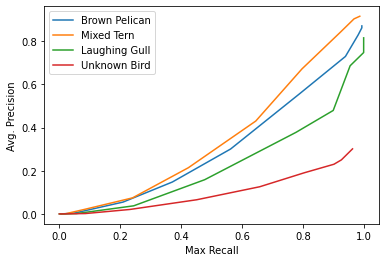

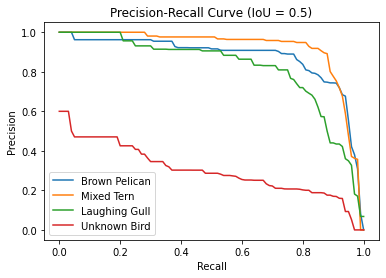

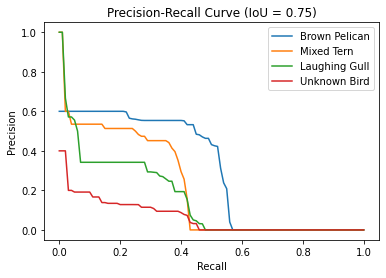

In [ ]:
# plot precision-recall curve for IoU=0.5
class_names = ["Brown Pelican","Mixed Tern","Laughing Gull","Unknown Bird"]
num_classes = len(class_names) 
recall = np.linspace(0,1,101)
fig,ax = plt.subplots()
fig_iou50, ax_iou50 = plt.subplots()
fig_iou75, ax_iou75 = plt.subplots()
for c_indx, class_name in enumerate(class_names): 
  test_avg_precision = np.mean(np.squeeze(test_precisions[:,:,c_indx,0,-1]),axis=1) 
  print(f"AP50 for {class_name}: {test_avg_precision[0]}")
  test_max_recall = np.squeeze(test_recalls[:,c_indx,0,-1])
  ax.plot(test_max_recall,test_avg_precision)
  test_precisions_iou50 = np.squeeze(test_precisions[0,:,c_indx,0,-1]) 
  ax_iou50.plot(recall,test_precisions_iou50)
  test_precisions_iou75 = np.squeeze(test_precisions[5,:,c_indx,0,-1])  
  ax_iou75.plot(recall,test_precisions_iou75)

ax.set(ylabel="Avg. Precision",
      xlabel="Max Recall")
ax_iou50.set(title="Precision-Recall Curve (IoU = 0.5)",
      ylabel="Precision",
      xlabel="Recall")
ax_iou75.set(title="Precision-Recall Curve (IoU = 0.75)",
      ylabel="Precision",
      xlabel="Recall")
ax.legend(class_names, loc='best')
ax_iou50.legend(class_names, loc='best')
ax_iou75.legend(class_names, loc='best')

plt.show()


 val examples:


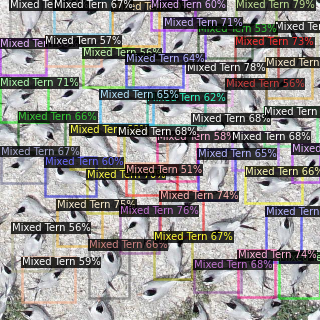

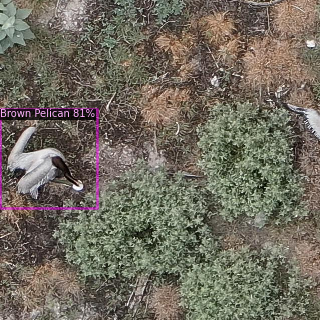

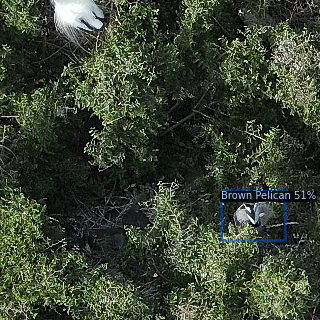

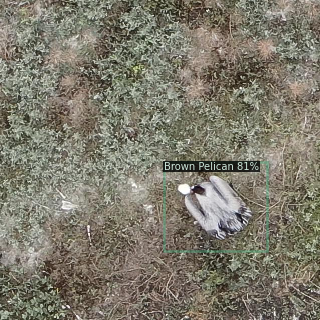

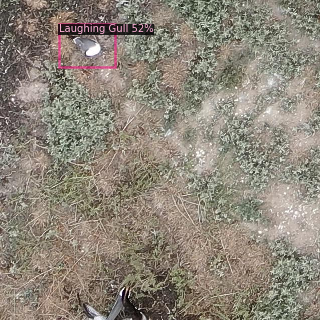


 test examples:


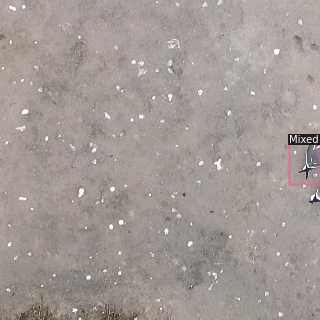

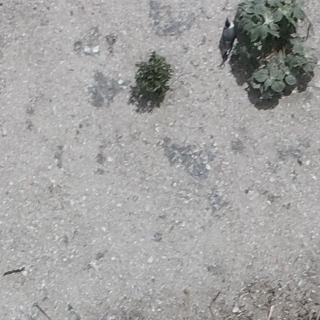

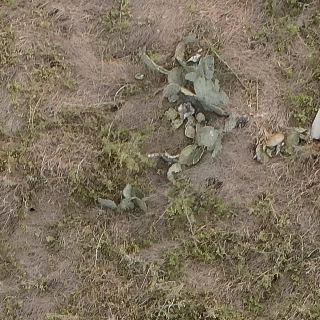

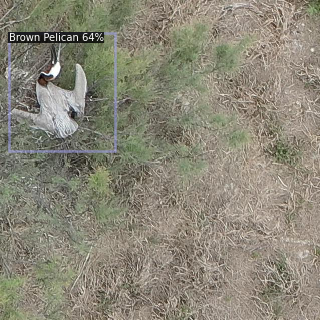

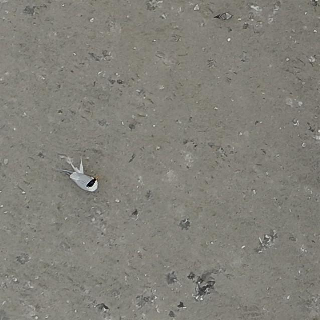

In [ ]:
from detectron2.utils.visualizer import ColorMode

class_names = ["Brown Pelican","Mixed Tern","Laughing Gull"]

for d in ["val", "test"]: 
  dataset_dicts = get_bird_species_dicts(os.path.join(data_dir,d),class_names,img_ext)
  print(f'\n {d} examples:')
  for k in random.sample(dataset_dicts, 5):    
      im = cv2.imread(k["file_name"])
      outputs = predictor(im)  # format is documented at https://detectron2.readthedocs.io/tutorials/models.html#model-output-format
      outputs = outputs["instances"].to("cpu")
      outputs = outputs[outputs.scores > 0.5]
      v = Visualizer(im[:, :, ::-1],
                    metadata=MetadataCatalog.get(f"birds_{d}"), 
                    scale=0.5, 
                    instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels. This option is only available for segmentation models
      )
      out = v.draw_instance_predictions(outputs)
      cv2_imshow(out.get_image()[:, :, ::-1])